<a href="https://colab.research.google.com/github/ikypakey/PCVK/blob/main/UTS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive/')


Mounted at /content/drive/


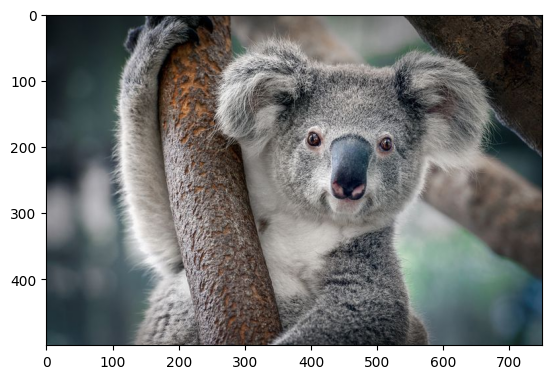

In [3]:
#untuk manipulasi array dan komputasi numerik
import numpy as np
#untuk melakukan manipulasi data, analisis data
import pandas as pd
#untuk melakukan pengolahan image
import cv2 as cv
#display image
from google.colab.patches import cv2_imshow
#untuk melakukan image processing
from skimage import io

from skimage import transform
#manipulasi gambar
from PIL import Image
#visualisasi data
import matplotlib.pylab as plt
img = cv.imread('/content/drive/MyDrive/koala.jpg')
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.imshow(img)

Resolusi image tinggi x lebar =  500 x 750


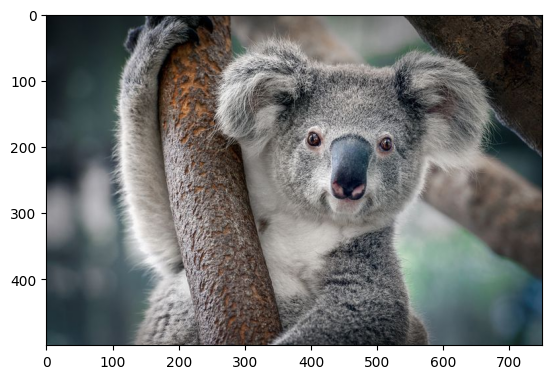

In [ ]:
#melihat ukura file image

tinggi = img.shape[0]
lebar= img.shape[1]
print('Resolusi image tinggi x lebar = ',tinggi,'x',lebar)
plt.imshow(img)

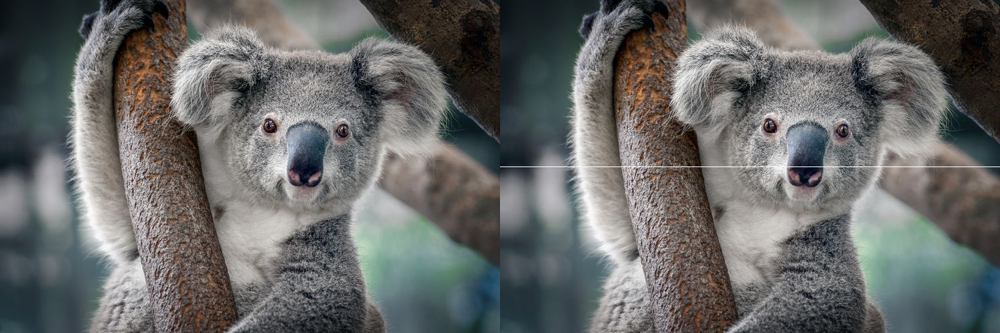

In [ ]:
image_2= cv.cvtColor(img, cv.COLOR_BGR2RGB)
image_3 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

#membuat garis horizontal ditengah image
image_3[250,:] = (255, 255, 255)
#menggabungkan image
final_frame = cv.hconcat((image_2,image_3))  
cv2_imshow(final_frame)

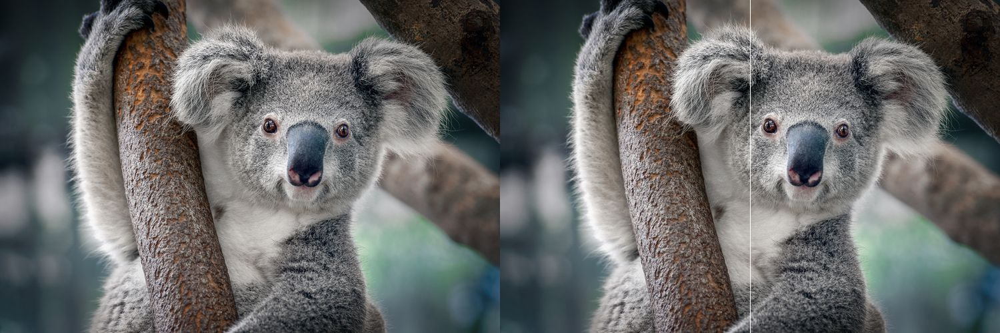

In [ ]:
#Garis Vertikal
image_2= cv.cvtColor(img, cv.COLOR_BGR2RGB)
image_3 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

#membuat garis horizontal ditengah image
for y in range (tinggi):
  image_3[y,int((lebar)/2)] = [255,255,255]
#menggabungkan image
final_frame = cv.hconcat((image_2,image_3))  
cv2_imshow(final_frame)

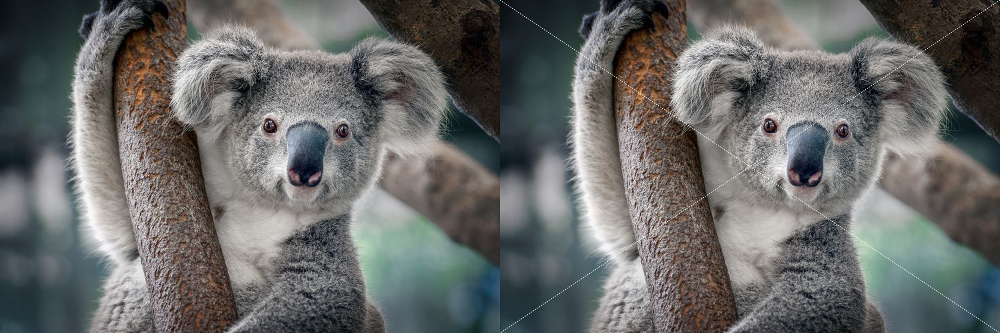

In [ ]:
#Garis silang
image_2= cv.cvtColor(img, cv.COLOR_BGR2RGB)
image_3 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

#membuat garis silang ditengah image
for x in range (tinggi):
  image_3[x,int(x*(lebar/tinggi))] = [255,255,255]
  image_3[x,lebar-1-int(x*(lebar/tinggi))] = [255,255,255]
#menggabungkan image
final_frame = cv.hconcat((image_2,image_3))  
cv2_imshow(final_frame)

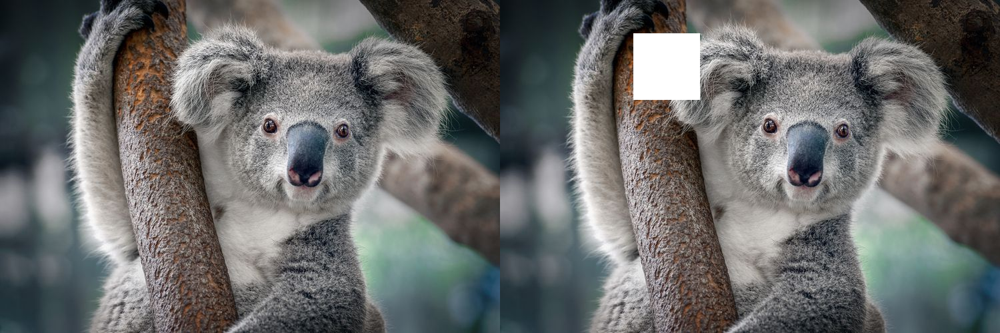

In [ ]:
#Kotak putih
image_2= cv.cvtColor(img, cv.COLOR_BGR2RGB)
image_3 = cv.cvtColor(img, cv.COLOR_BGR2RGB)

# tinggi / baris
for y in range (50,150):
  # lebar / kolom
  for x in range(200,300):
    image_3[y,x] = [255,255,255]
  
#menggabungkan image
final_frame = cv.hconcat((image_2,image_3))  
cv2_imshow(final_frame)

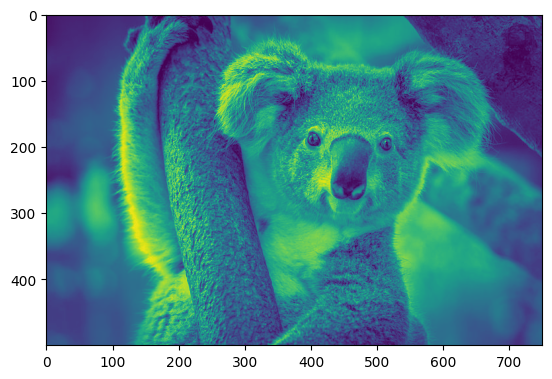

In [5]:
#Grayscale image
img_grayp2 = cv.imread('/content/drive/MyDrive/koala.jpg', cv.IMREAD_GRAYSCALE)
plt.imshow(img_grayp2)

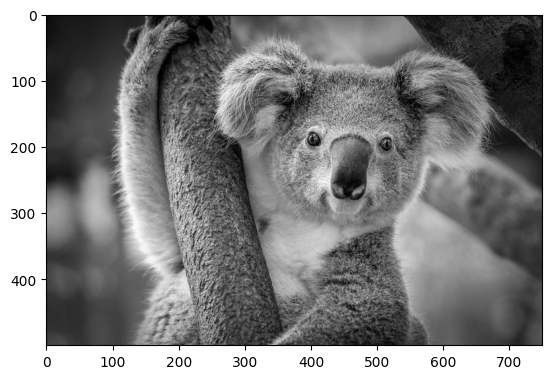

In [ ]:
#Colormap Gray
plt.imshow(img_grayp2, cmap='gray')

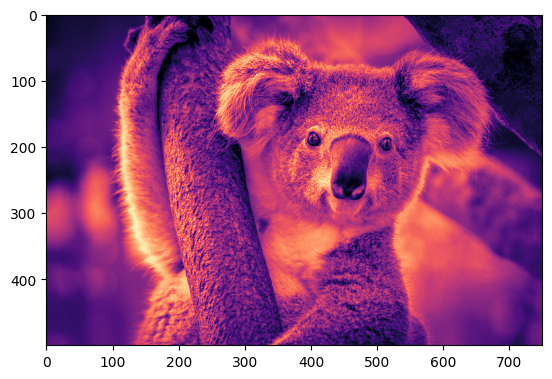

In [ ]:
#Magma
plt.imshow(img_grayp2, cmap='magma')

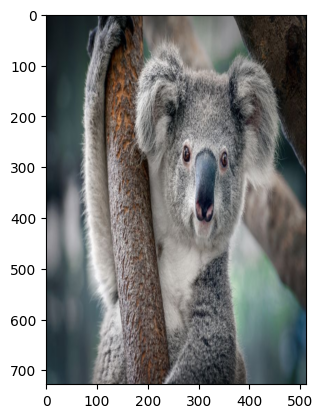

In [ ]:
#resize image

imgp2= cv.resize((img),(512,728))
plt.imshow(imgp2)

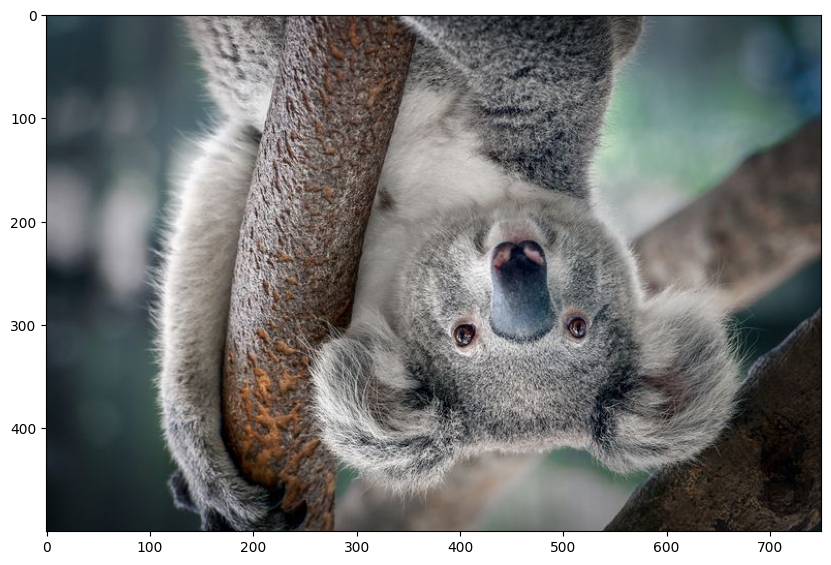

In [8]:
#flip image
img_flip = cv.flip((img), 0)


#tampilkan plot dengan ukuran canvas yg lebih besar
fig = plt.figure(figsize=(10,10))    #ubah - ubah ukuran (10,10) sesuai kebutuhan
ax = fig.add_subplot(111)
ax.imshow(img_flip)

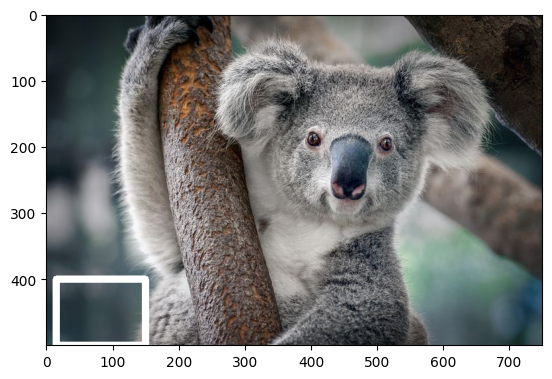

In [10]:
#rectangle
imgw2 = cv.imread('/content/drive/MyDrive/koala.jpg')
imgper2= cv.cvtColor(imgw2, cv.COLOR_BGR2RGB)
plt.imshow(imgper2)


cv.rectangle(imgper2,pt1=(150,400),pt2=(15,500),color=(255,255,255),thickness=10) #kolom kanan, baris atas, kolom kiri baris bawah
plt.imshow(imgper2)

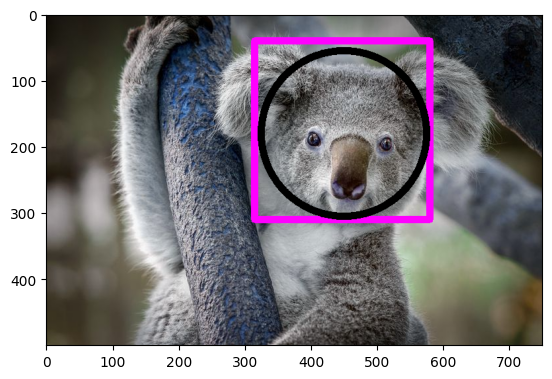

In [17]:
#image with circle
imgc2 = cv.imread('/content/drive/MyDrive/koala.jpg')
plt.imshow(imgc2)

#rectangle
cv.rectangle(imgc2,pt1=(315,40),pt2=(580,310),color=(255,0,255),thickness=10) #kolom kanan, baris atas, kolom kiri baris bawah
plt.imshow(imgc2)

#circle
cv.circle(imgc2, center=(450,180),radius=125,color=(0,0,0),thickness=10) #baris kolom
plt.imshow(imgc2)

### Pertemuan 3




Tranformasi Brightness

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


 Mengubah tingkat kecerahan citra
---------------------------------
Masukkan nilai kecerahan: 50


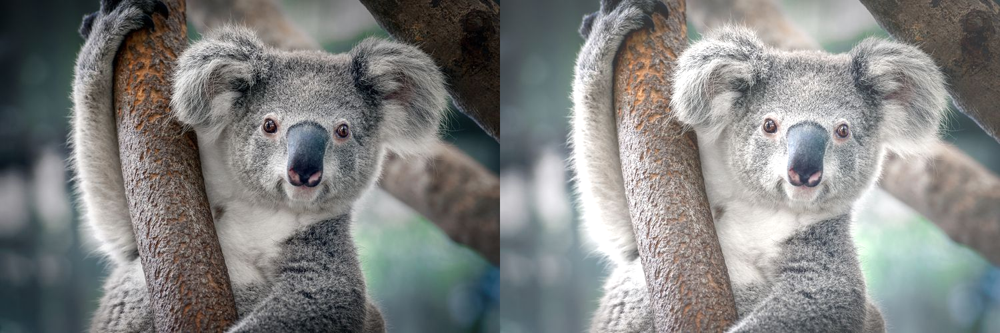

In [ ]:
print(' Mengubah tingkat kecerahan citra')
print('---------------------------------')

try:
    brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
    print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/koala.jpg')
brightness_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        for c in range(original.shape[2]):
            brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)


final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

Transformasi contrast

Mengubah kontras dan tingkat kecerahan citra
--------------------------------------------
Masukkan tingkat kecerahan [-255 - 255] : 30
Masukkan kontras [1.0 - 3.0] : 2


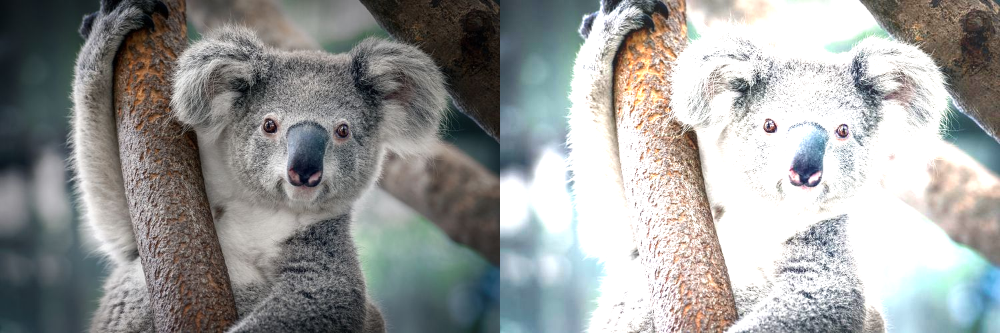

In [ ]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('--------------------------------------------')
try:
  brightness = int(input('Masukkan tingkat kecerahan [-255 - 255] : '))
  contrast = float(input('Masukkan kontras [1.0 - 3.0] : '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/koala.jpg')
brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(contrast*original[y,x,c] + brightness, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

Transformasi log brightness

Mengubah tingkat kecerahan citra dengan Transformasi Log
--------------------------------------------
Masukkan tingkat kecerahan : 45


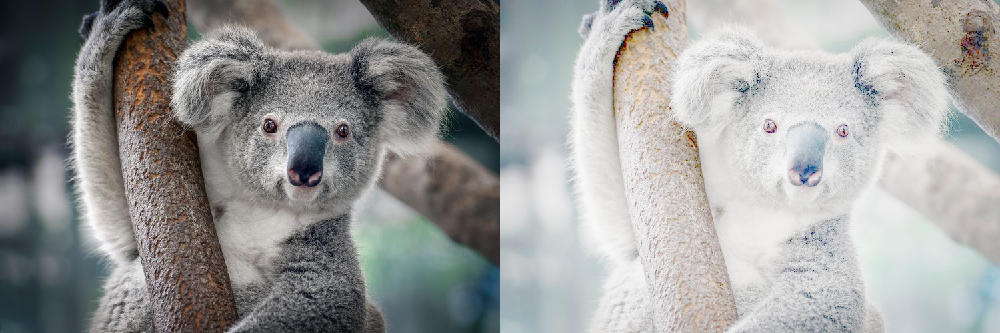

In [ ]:
print('Mengubah tingkat kecerahan citra dengan Transformasi Log')
print('--------------------------------------------')
try:
  brightness = int(input('Masukkan tingkat kecerahan : '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/koala.jpg')
brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(brightness*(np.log(1.0+original[y,x,c])), 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

Averaging

Averaging
--------------------------------------------------------------------


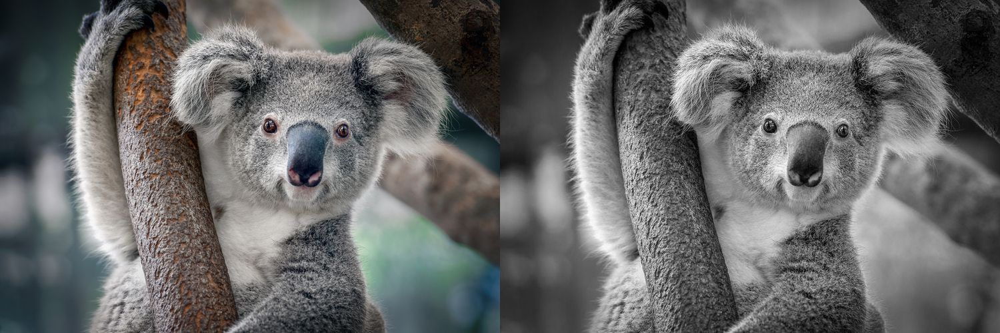

In [ ]:
print('Averaging')
print('--------------------------------------------------------------------')
image_pertemuan3 = cv.imread('/content/drive/MyDrive/koala.jpg')
image_abu = plt.imread('/content/drive/MyDrive/koala.jpg')

R, G, B = original[:,:,0], original[:,:,1], original[:,:,2]
average = (R/3 + G/3 + B/3)

image_abu[:,:,0] = average
image_abu[:,:,1] = average
image_abu[:,:,2] = average


final_frame = cv.hconcat((image_pertemuan3, image_abu))
cv2_imshow(final_frame)

Lightness <br>
Grayscale lighness = (max[R, G, B] + min [R, G, B]) / 2

Lightness
--------------------------------------------------------------------


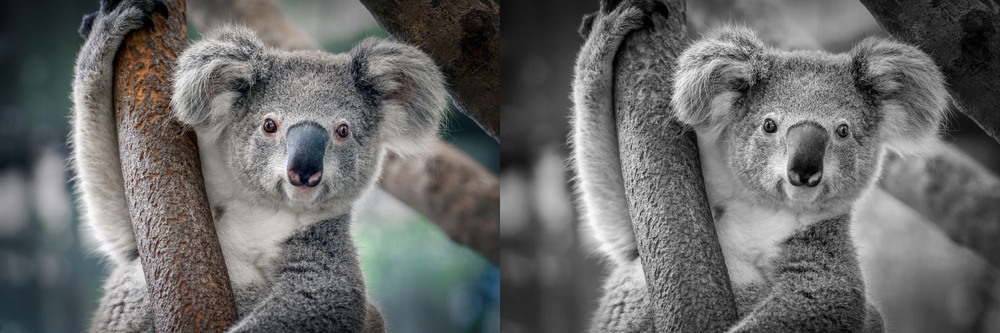

In [ ]:
print('Lightness')
print('--------------------------------------------------------------------')

original = cv.imread('/content/drive/MyDrive/koala.jpg')

image_abu = cv.imread('/content/drive/MyDrive/koala.jpg')
image_abu = cv.cvtColor(image_abu,cv.COLOR_BGR2RGB)

R, G, B = image_abu[:,:,0], image_abu[:,:,1], image_abu[:,:,2]
lightness = np.maximum(R,G,B)/2+ np.minimum(R,G,B)/2

image_abu[:, :, 0] = lightness
image_abu[:, :, 1] = lightness
image_abu[:, :, 2] = lightness


final_frame = cv.hconcat((original, image_abu))
cv2_imshow(final_frame)

Luminance <br> Grayscale luminance = 0.21R + 0.72G + 0.07B

Luminance
--------------------------------------------------------------------


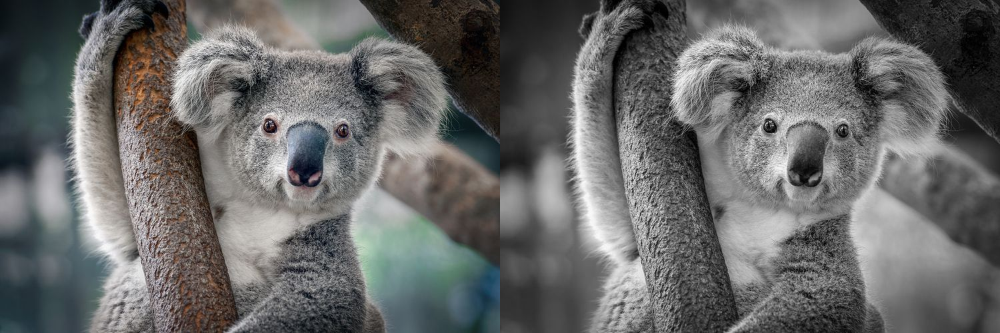

In [ ]:
print('Luminance')
print('--------------------------------------------------------------------')

original = cv.imread('/content/drive/MyDrive/koala.jpg')

image_abu = cv.imread('/content/drive/MyDrive/koala.jpg')
image_abu = cv.cvtColor(image_abu,cv.COLOR_BGR2RGB)

R, G, B = original[:,:,0], original[:,:,1], original[:,:,2]
luminance = 0.21*R+0.72*G+0.07*B

image_abu[:, :, 0] = luminance
image_abu[:, :, 1] = luminance
image_abu[:, :, 2] = luminance

final_frame = cv.hconcat((original, image_abu))
cv2_imshow(final_frame)

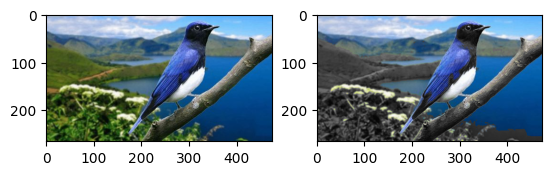

In [38]:
# load image
import cv2

img_path = cv.imread('/content/drive/MyDrive/burung.jpg')
original = cv.cvtColor(img_path,cv.COLOR_BGR2RGB)
gray_blue_image = original.copy()
one_color = np.array(original)
for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        if (one_color[y,x,2] > 100):
            gray_blue_image[y,x,:] = [0, 0, original[y,x,2]]
        else:
          one_color[y,x]= np.mean(one_color[y,x])

fig, ax = plt.subplots(1,2)
ax[0].imshow(original)
ax[1].imshow(one_color)

## Pertemuan 5

Gamma Correction

 Gamma Correction pada citra 
----------------------------------
Masukkan nilai Gamma: 3


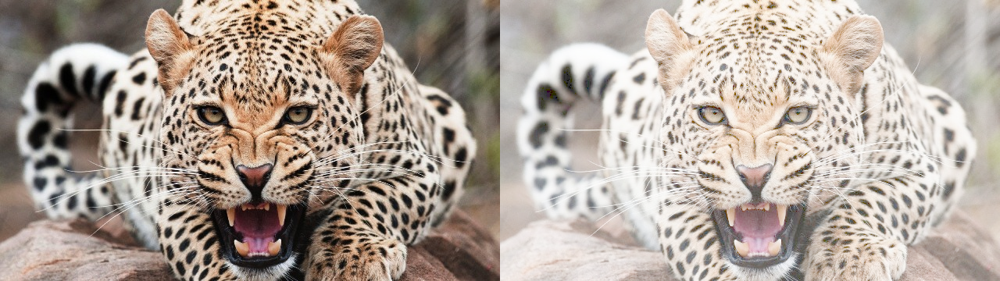

In [ ]:
print(' Gamma Correction pada citra ')
print('----------------------------------')
try: 
  gamma = int(input('Masukkan nilai Gamma: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')
gamma_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
     gamma_image[y,x,c] = np.clip(255 * pow(original[y,x,c] / 255, (1 / gamma)), 0, 255)
     
final_frame = cv.hconcat((original, gamma_image))
cv2_imshow(final_frame)

Image Depth

 Simulasi Image Depth 
----------------------
Masukkan nilai bit depth [1-7]: 5


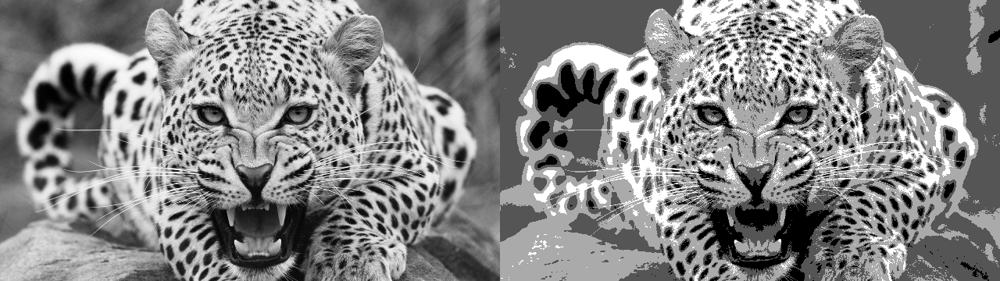

In [ ]:
original = cv.imread('/content/drive/MyDrive/MacanTutul.jpg', cv.IMREAD_GRAYSCALE) 
depth_image = np.zeros(original.shape, original.dtype)

print(' Simulasi Image Depth ')
print('----------------------')
try:
  bd = float(input('Masukkan nilai bit depth [1-7]: '))
except ValueError:
  print('Error, not a number')

bit = 2
level = 255 / (pow(2,bit)-1) 

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    depth_image[y,x] = np.clip(round(original[y,x] / level) * level, 0, 255);
     

final_frame = cv.hconcat((original, depth_image))
cv2_imshow(final_frame)

Average Denoising

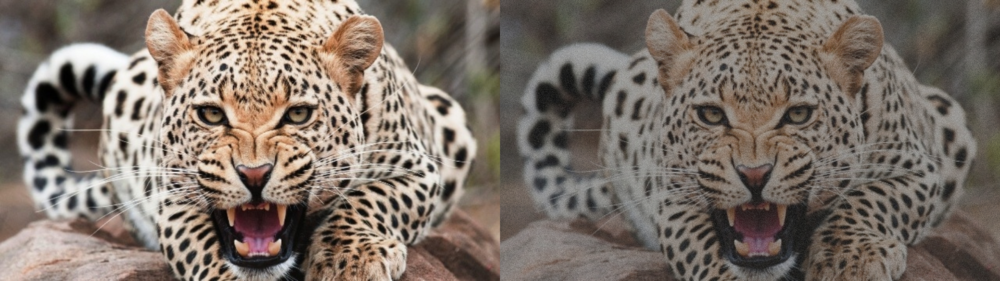

Nilai PSNR adalah 28.116997660501397 (dB)
Nilai MSE adalah 100.31839952256945


In [ ]:
original = cv.imread('/content/drive/MyDrive/Macan_noises/original.jpg')
cv_img = []
for img in glob.glob('//content/drive/MyDrive/Macan_noises/*.jpg'):
 n= cv.imread(img)
 cv_img.append(n)


first_index = cv_img[0]
noise_number = 35 # nomor (array) gambar pada folder noises 

for i in range(noise_number):
    if i == 0:
        pass
    else:
        alpha = 1.0 / (i + 1)
        beta = 1.0 - alpha
        first_index = cv.addWeighted(cv_img[i], alpha, first_index, beta, 0.0)

def PSNR(original, compressed): 
    mse = np.mean((original - compressed) ** 2) 
    if(mse == 0): 
        return 100, mse
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse)) 
    return psnr, mse


compressed = first_index
psnr = PSNR(original, compressed)
galaxy_frame = cv.hconcat((original, first_index))
cv2_imshow(galaxy_frame)


psnr, mse = PSNR(original, compressed)
print('Nilai PSNR adalah',psnr, '(dB)')
print('Nilai MSE adalah',mse)

masking image

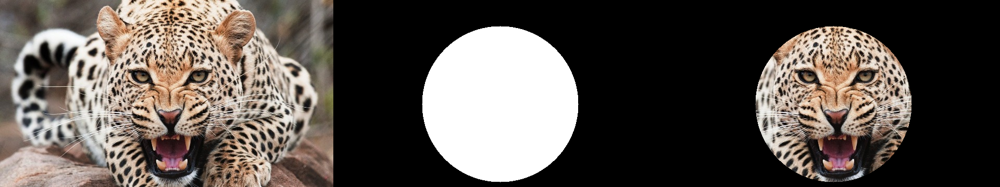

In [ ]:
img_mask = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')

mask = np.zeros(img_mask.shape, dtype=np.uint8)
mask = cv.circle(mask, (320, 200), 150, (255,255,255), -1)

result = img_mask & mask

final_frame = cv.hconcat((img_mask, mask, result))
cv2_imshow(final_frame)

or

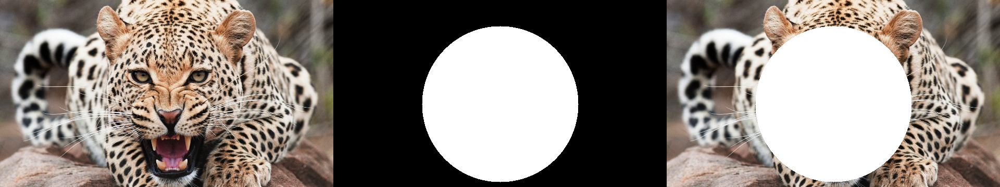

In [ ]:
img_mask = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')

mask = np.zeros(img_mask.shape, dtype=np.uint8)
mask = cv.circle(mask, (320, 200), 150, (255,255,255), -1)

masked = img_mask | mask

lion_frame = cv.hconcat((img_mask, mask, masked))
cv2_imshow(lion_frame)

Not

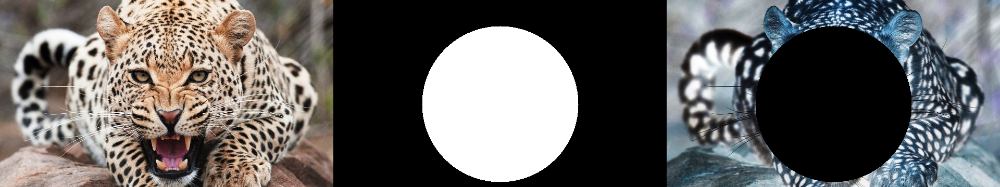

In [ ]:
img_mask = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')

mask = np.zeros(img_mask.shape, dtype=np.uint8)
mask = cv.circle(mask, (320, 200), 150, (255,255,255), -1)

masked = ~img_mask & ~mask

lion_frame = cv.hconcat((img_mask, mask, masked))
cv2_imshow(lion_frame)

NAND atau NOT AND

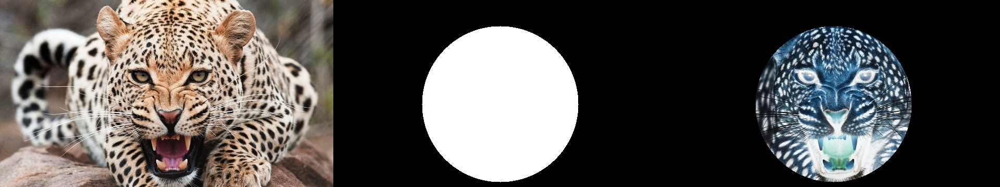

In [ ]:
img_mask = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')

mask = np.zeros(img_mask.shape, dtype=np.uint8)
mask = cv.circle(mask, (320, 200), 150, (255,255,255), -1)

masked = ~img_mask & mask

lion_frame = cv.hconcat((img_mask, mask, masked))
cv2_imshow(lion_frame)

XOR

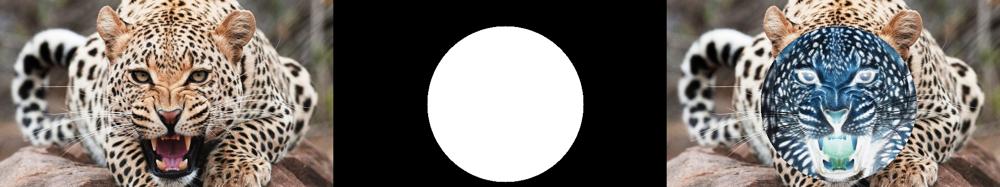

In [ ]:
img_mask = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')

mask = np.zeros(img_mask.shape, dtype=np.uint8)
mask = cv.circle(mask, (330, 200), 150, (255,255,255), -1)

masked = img_mask ^ mask

lion_frame = cv.hconcat((img_mask, mask, masked))
cv2_imshow(lion_frame)

**Histogram** **Citra**

In [34]:
import math
import glob
import os

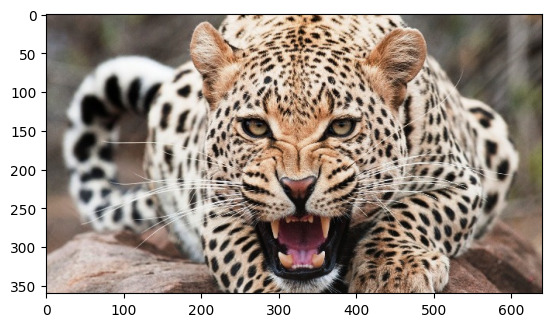

In [ ]:
imgm6 = cv.imread('/content/drive/MyDrive/MacanTutul.jpg')
imgw6 = cv.cvtColor(imgm6, cv.COLOR_BGR2RGB)
plt.imshow(imgw6)

<BarContainer object of 256 artists>

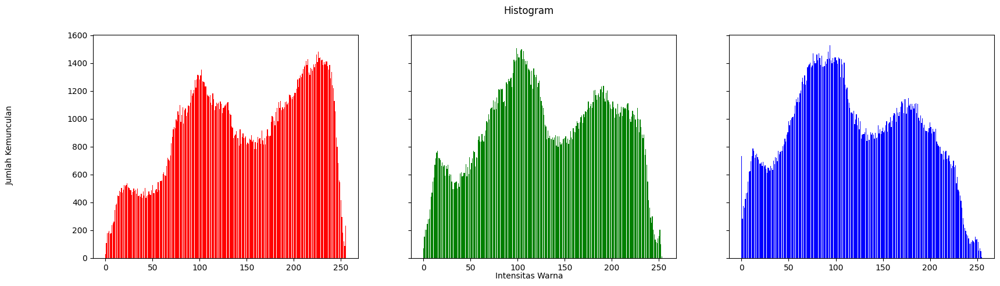

In [ ]:
imgw6 = cv.imread('/content/drive/MyDrive/MacanTutul.jpg') #input image
height, width, depth = np.shape(imgw6) #hitung kemunculan pixel
names = np.arange(256)

#memberi nilai awal 0 untuk sumbu y
blue = [0]*256
green = [0]*256
red = [0]*256

#membuat histogram dengan x sbg height / intensitas warna dan y sbg jmlah kemunculan
for y in range(0,height):
  for x in range(0,width):
    blue[imgw6[y][x][0]] += 1 #menambahkan 1 jika ada angka tsb
    green[imgw6[y][x][1]] += 1
    red[imgw6[y][x][2]] += 1

#menampilkan histogram citra
names = np.arange(256)
fig, axs = plt.subplots(1, 3, figsize=[20,5], sharex=True, sharey=True)
fig.suptitle('Histogram')
fig.text(0.05, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
axs[0].bar(names, red, color='red')
axs[1].bar(names, green, color='green')
axs[2].bar(names, blue, color='blue')

Histogram Equalization


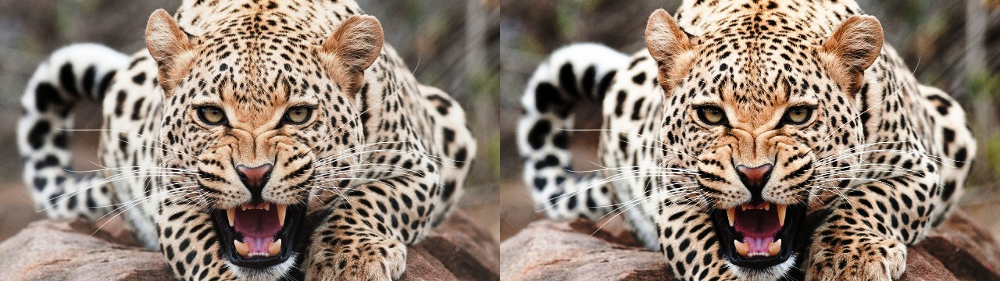

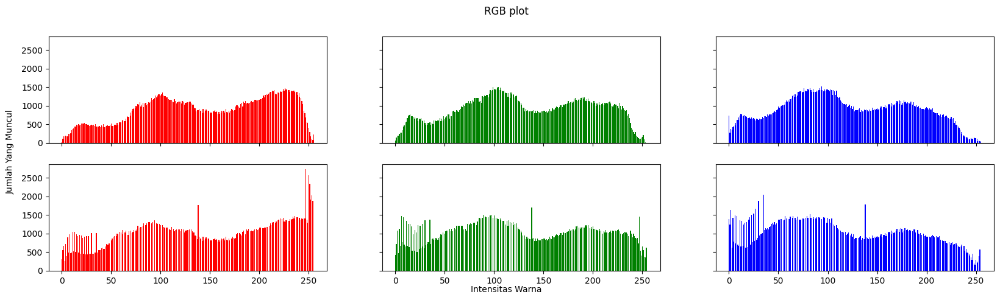

In [ ]:
imgw6h = cv.imread('/content/drive/MyDrive/MacanTutul.jpg') 
def histog(imgw6h):
  height, width, depth = np.shape(imgw6h) # mengetahui tinggi lebar dan kedalaman
  ax = np.zeros((3,256)) 
  for y in range(0,height) : 
    for x in range(0,width) :
      ax[0][imgw6h[y][x][0]] += 1 # untuk menghitung banyaknya angka yg sama
      ax[1][imgw6h[y][x][1]] += 1
      ax[2][imgw6h[y][x][2]] += 1 
  return ax

histo_asli = histog(imgw6h) 

#convert to Numpy array 
img_array = np.asarray(imgw6h)

#Step 1: Normalized cumulative histogram
#flatten image array and calculate histogram via binning 
histogram_array = np.bincount(img_array.flatten(), minlength=256)

#normalize 
num_pixels = np. sum(histogram_array) 
histogram_array = histogram_array/num_pixels

#normalized cumulative histogram 
chistogram_array = np.cumsum(histogram_array)

#Step 2: Pixel mapping lookup table
transform_map = np.floor(255 * chistogram_array). astype (np.uint8)

#Step 3: Transformation
# flatten image array into 10 list 
img_list = list(img_array.flatten())

# transform pixel values to equalize 
eq_img_list = [transform_map[p] for p in img_list]

# reshape and write back into img_array 
eq_img_array = np.reshape(np.asarray(eq_img_list), img_array.shape) 
imgw6h2 = eq_img_array

equal_histo = histog(imgw6h2)

final_frame = cv.hconcat((imgw6h, imgw6h2)) #concatenate image
cv2_imshow(final_frame)

names = np.arange (256) 
isgrayimg = np.array_equal(blue, green, red)
if (isgrayimg == False):
  fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey=True) 
  fig.suptitle('RGB plot') 
  fig.text(0.09, 0.5, 'Jumlah Yang Muncul', va='center', rotation='vertical') 
  fig.text(0.5, 0.04, 'Intensitas Warna', ha='center') 
  axs[0,0].bar(names, histo_asli[2], color='red') 
  axs[0,1].bar(names, histo_asli[1], color='green') 
  axs[0,2].bar(names, histo_asli[0], color='blue') 
  axs[1,0].bar(names, equal_histo[2], color='red') 
  axs[1,1].bar(names, equal_histo[1], color='green')
  axs[1,2].bar(names, equal_histo[0], color='blue') 
else:
  fig, axs = plt. subplots(1, 2, figsize=[20,5], sharex=True, sharey=True) 
  fig. suptitle('RGB plot') 
  fig.text(0.09, 0.5, 'Jumlah Yang Muncul', va='center', rotation='vertical') 
  fig.text(0.5, 0.94, 'Intensitas Warna', ha='center') 
  axs[0,0].bar(names, histo_asli[2], color='gray') 
  axs[0,1].bar(names, equal_histo[2], color='gray')
     

Pemetaan Warna

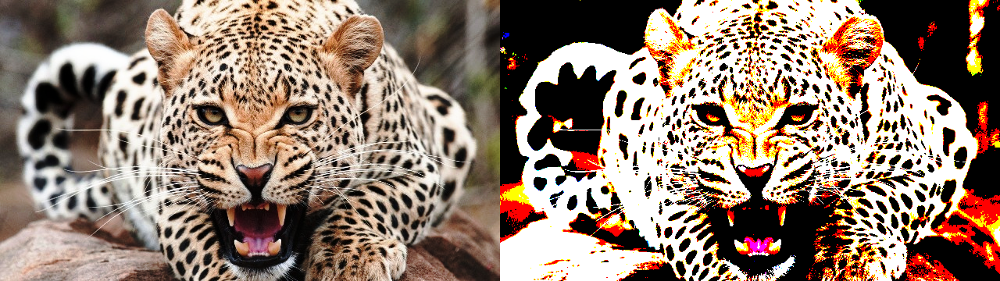

In [ ]:
imgw63 = cv.cvtColor(imgw63, cv.COLOR_BGR2RGB)
imgw6p3 = cv.cvtColor(imgw6p3, cv.COLOR_BGR2RGB)
final_frame = cv.hconcat((imgw63, imgw6p3))
cv2_imshow(final_frame)
cv.imwrite('/content/drive/MyDrive/MacanTutul.jpg', imgw6p3)

def closestColour (r, g, b):
  pValue = 0
  minDistance = 255*255 + 255*255 + 255*255 + 1
  warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]]
  for i in range(len(warnaPallette)):
    rDiff = r - warnaPallette[i][0]
    gDiff = g - warnaPallette[i][1]
    bDiff = b - warnaPallette[i][2]
    distance = rDiff*rDiff + gDiff*gDiff + bDiff*bDiff
    if (distance < minDistance):
      minDistance = distance
      pValue = i
  return pValue

warnaPallette = [[0, 0, 0], [255, 0, 0], [0, 255, 0], [255, 255, 0], [0, 0, 255], [255, 0, 255], [0, 255, 255], [255, 255, 255]]
imgw63 = cv.cvtColor(imgw6h2, cv.COLOR_BGR2RGB)
imgw6p3 = np.zeros(imgw63.shape, imgw63.dtype)

for y in range(0, imgw63.shape[0]):
  for x in range(0, imgw63.shape[1]):
    baru = closestColour(imgw63[y, x, 0], imgw63[y, x, 1], imgw63[y, x, 2])
    imgw6p3[y, x] = warnaPallette[baru]
    

Dithering 

Gambar Asli


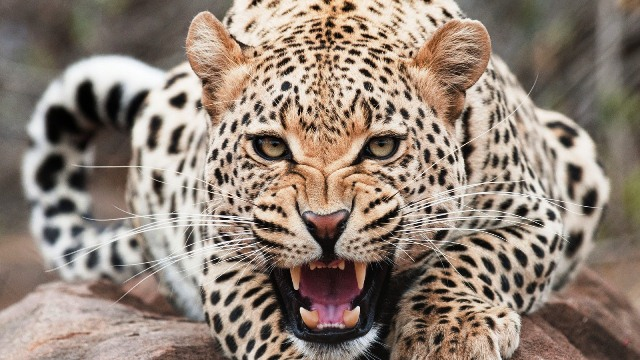


Hasil Dithering dengan jarak tetangga 1 pixel


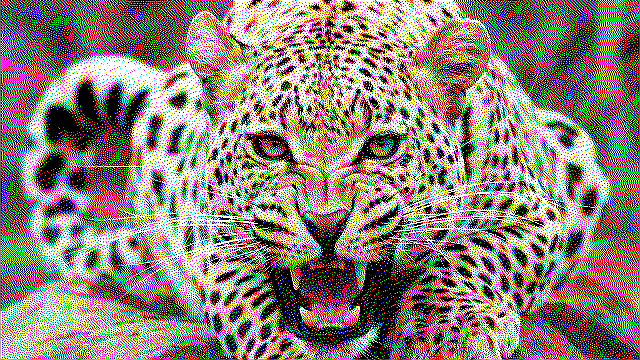

In [39]:
input_image = cv.imread('/content/drive/MyDrive/macam.jpg')
output_image = input_image.copy()

def minmax(v):
    if v > 255:
        v = 255
    if v < 0:
        v = 0
    return v

def dithering_color(img, jarakPixel):
    # mengambil dimensi gambar
    h = img.shape[0]
    w = img.shape[1]
     
    # akses pixel
    for y in range(0, h-1):
        for x in range(1, w-1):
            # jarak pixel tetangga
            old_b = img[y, x, 0]
            old_g = img[y, x, 1]
            old_r = img[y, x, 2]
            
            # menghitung pixel baru berdasarkan jarak dan juga batasan warna yang dimiliki
            new_b = np.round(jarakPixel * old_b/255.0) * (255/jarakPixel)
            new_g = np.round(jarakPixel * old_g/255.0) * (255/jarakPixel)
            new_r = np.round(jarakPixel * old_r/255.0) * (255/jarakPixel)

            img[y, x, 0] = new_b
            img[y, x, 1] = new_g
            img[y, x, 2] = new_r

            # Menghitung kuantisasi error untuk masuk rumus
            quant_error_b = old_b - new_b
            quant_error_g = old_g - new_g
            quant_error_r = old_r - new_r

            # implementasi rumus dithering Floyd and Steinberg
            img[y, x+1, 0] = minmax(img[y, x+1, 0] + quant_error_b * 7 / 16.0)
            img[y, x+1, 1] = minmax(img[y, x+1, 1] + quant_error_g * 7 / 16.0)
            img[y, x+1, 2] = minmax(img[y, x+1, 2] + quant_error_r * 7 / 16.0)
            
            img[y+1, x-1, 0] = minmax(img[y+1, x-1, 0] + quant_error_b * 3 / 16.0)
            img[y+1, x-1, 1] = minmax(img[y+1, x-1, 1] + quant_error_g * 3 / 16.0)
            img[y+1, x-1, 2] = minmax(img[y+1, x-1, 2] + quant_error_r * 3 / 16.0)


            img[y+1, x, 0] = minmax(img[y+1, x, 0] + quant_error_b * 5 / 16.0)
            img[y+1, x, 1] = minmax(img[y+1, x, 1] + quant_error_g * 5 / 16.0)
            img[y+1, x, 2] = minmax(img[y+1, x, 2] + quant_error_r * 5 / 16.0)


            img[y+1, x+1, 0] = minmax(img[y+1, x+1, 0] + quant_error_b * 1 / 16.0)
            img[y+1, x+1, 1] = minmax(img[y+1, x+1, 1] + quant_error_g * 1 / 16.0)
            img[y+1, x+1, 2] = minmax(img[y+1, x+1, 2] + quant_error_r * 1 / 16.0)

    return img

output_image = dithering_color(output_image, 1)
print("Gambar Asli")
cv2_imshow(input_image)
print("\nHasil Dithering dengan jarak tetangga 1 pixel")
cv2_imshow(output_image)

Spasial Filter

In [21]:
def convolution2d(image, kernel, stride, padding):
    # Korelasi silang
    kernel = np.flipud(np.fliplr(kernel))

    # Mendapatkan shape dari kernel dan IMAGE sesuai parameter masukan ( height width)
    xKernShape = kernel.shape[0]
    yKernShape = kernel.shape[1]
    xImgShape = image.shape[0]
    yImgShape = image.shape[1]

    # Menghitung  dimensi output dari operasi konvolusi antara suatu kernel dan gambar  diketahui pixelnya brp 
    xOutput = int(((xImgShape - xKernShape + 2 * padding) / stride) + 1)
    yOutput = int(((yImgShape - yKernShape + 2 * padding) / stride) + 1)
    output = np.zeros((xOutput, yOutput)) #membuat array output dengan menggunakan np.zeros dengan ukuran sesuai dengan xOutput dan yOutput

    # Menerapkan equal padding ke semua sisi
    if padding != 0:
        imagePadded = np.zeros((image.shape[0] + padding*2, image.shape[1] + padding*2))
        imagePadded[int(padding):int(-1 * padding), int(padding):int(-1 * padding)] = image
        #print(imagePadded)
    else:
        imagePadded = image

    # Akses pixel
    for y in range(image.shape[1]): #berjalan pada baris keberapa 
        # Keluar dari konvolusi
        if y > image.shape[1] - yKernShape: #ngcecek kolom 0 1 2 yg dpt di eksekusi
            break
        # Konvolusi dilakukan, jika hasil bagi y dengan stride = 0
        if y % stride == 0: 
            for x in range(image.shape[0]):
                # Melanjutkan ke baris berikutnya setelah kernel berada di luar batas
                if x > image.shape[0] - xKernShape:
                    break
                try:
                    # Konvolusi dilakukan, jika hasil bagi x dengan stride = 0
                    if x % stride == 0:
                        output[x, y] = (kernel * imagePadded[x: x + xKernShape, y: y + yKernShape]).sum()
                except:
                    break

    return output

In [26]:
imgsf7 = cv.imread('/content/drive/MyDrive/macam.jpg')
img_gray = cv.cvtColor(imgsf7, cv.COLOR_BGR2GRAY)

In [27]:
# Image Sharpen
kernal_sharpen = np.array([[0,-1,0],
                           [-1,5,-1],
                           [0,-1,0]])


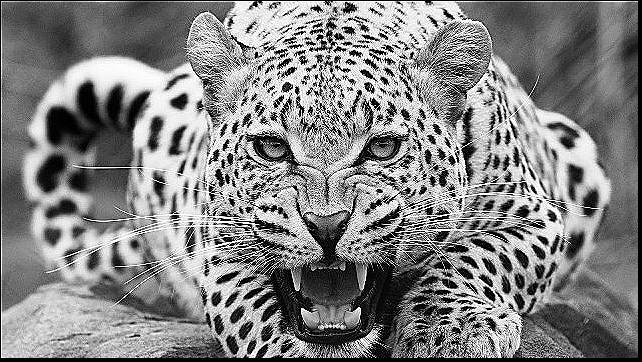

In [28]:
img_sharpen = img_gray.copy()
cv2_imshow(convolution2d(img_sharpen,kernal_sharpen,1,2))

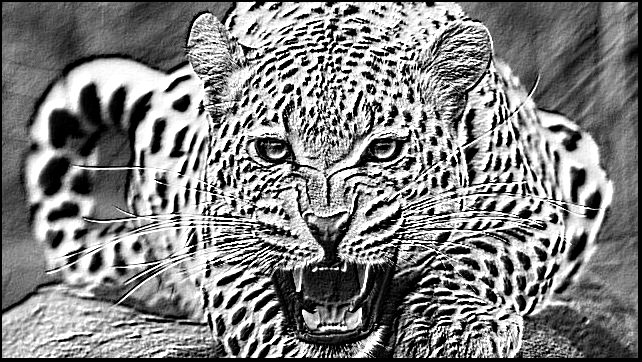

In [29]:
# Emboss
kernel_emboss = np.array([[-2,-1,0],
                          [-1,1,1],
                          [0,1,2]])

img_emboss = img_gray.copy()
cv2_imshow(convolution2d(img_emboss,kernel_emboss,1,2))

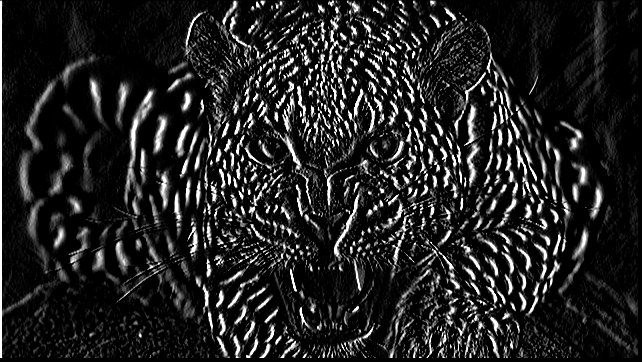

In [30]:
kernel_sobel = np.array([[1,0,-1],
                         [2,0,-2],
                         [1,0,-1]])
img_sobel = img_gray.copy()
cv2_imshow(convolution2d(img_sobel,kernel_sobel,1,2))

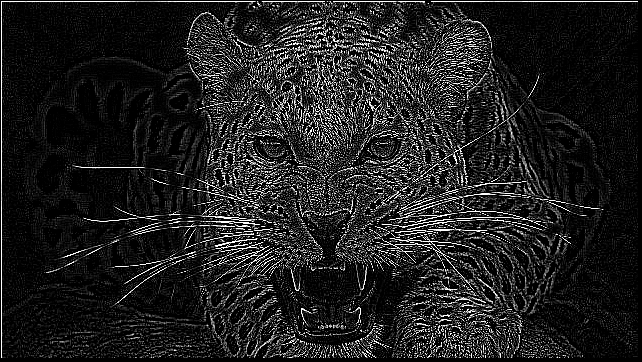

In [31]:
kernel_canny = np.array([[-1,-1,-1],
                         [-1,8,-1],
                         [-1,-1,-1]])
img_canny = img_gray.copy()
cv2_imshow(convolution2d(img_canny,kernel_canny,1,2))

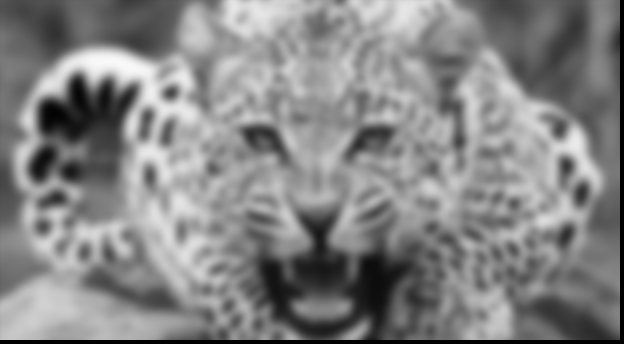

In [36]:
kernel_size = 21
sigma = math.sqrt(kernel_size)
gaussian_kernel = cv.getGaussianKernel(kernel_size, sigma)
kernel_gaussian = gaussian_kernel @ gaussian_kernel.transpose()
img_gaus = img_gray.copy()
cv2_imshow(convolution2d(img_gaus,kernel_gaussian,1,2))